In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Importing Libraries and Setting Up Environment

In [80]:
import datetime
import random
import time

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    f1_score,
    precision_score,
    recall_score,
    ConfusionMatrixDisplay
)
from sklearn.preprocessing import LabelEncoder

import torch
from torch.utils.data import DataLoader, RandomSampler, SequentialSampler, TensorDataset
from transformers import (
    AdamW,
    BertConfig,
    BertForSequenceClassification,
    BertTokenizer,
    get_linear_schedule_with_warmup,
    TextClassificationPipeline,
    pipeline
)

from psutil import virtual_memory

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

import tensorflow as tf
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

torch.cuda.empty_cache()


In [5]:
def check_gpu():
    gpu_info = !nvidia-smi
    gpu_info = '\n'.join(gpu_info)
    if 'failed' in gpu_info:
        print('Not connected to a GPU')
    else:
        print(gpu_info)

    device_name = tf.test.gpu_device_name()
    if device_name == '/device:GPU:0':
        print('GPU:', torch.cuda.get_device_name(0))
    elif device_name == '':
        print('Not connected to a GPU')
    else:
        raise SystemError('GPU device not found')

    ram_gb = virtual_memory().total / 1e9
    print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))
    print('You are using a {}-RAM runtime!'.format('high' if ram_gb >= 20 else 'low'))

check_gpu()

Thu Mar 30 19:51:54 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   29C    P0    43W / 400W |      0MiB / 40960MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Loading Data and Tokenizer

In [24]:
tokenizer = BertTokenizer.from_pretrained('dbmdz/bert-base-turkish-128k-uncased', do_lower_case=True)

In [6]:
df_ = pd.read_csv('/content/drive/MyDrive/Nane&Limon/Dataset/obs_clean_data_support_turkish_chars.csv')
shap_df_ = pd.read_csv('/content/drive/MyDrive/Nane&Limon/Dataset/shap.csv')

In [7]:
df = df_.copy()
shap_df = shap_df_.copy()

## Quick look

In [8]:
value_counts_df = df['target'].value_counts().reset_index()
value_counts_df.columns = ['target', 'count']
value_counts_df.sort_values(by='count', ascending=False)

,target,count
0,OTHER,4760
1,INSULT,2738
2,SEXIST,2533
3,PROFANITY,2522
4,RACIST,2462


In [9]:
print("Number of text observations: ", df.shape[0])

Number of text observations:  15015


In [10]:
df.head(8)

,text,target,is_offensive
0,çürük dişli,INSULT,1
1,bu adamın islama ve müslümanlara verdiği zarar...,RACIST,1
2,erkekler zora gelmez,SEXIST,1
3,utanmazın götüne kazık sokmuşlar bu tıkırtı ne...,PROFANITY,1
4,otomasyon sistemlerine doğrudan bağlanabilir,OTHER,0
5,amını siktiğimin yarrağı,PROFANITY,1
6,ekipte bir cücemiz eksikti o da oldu,INSULT,1
7,kadın yönetici sayısı oldukça az olduğu için ş...,SEXIST,1


In [11]:
label_encoder = LabelEncoder()

In [12]:
df['target'] = label_encoder.fit_transform(df['target'])

In [13]:
df.head(8)

,text,target,is_offensive
0,çürük dişli,0,1
1,bu adamın islama ve müslümanlara verdiği zarar...,3,1
2,erkekler zora gelmez,4,1
3,utanmazın götüne kazık sokmuşlar bu tıkırtı ne...,2,1
4,otomasyon sistemlerine doğrudan bağlanabilir,1,0
5,amını siktiğimin yarrağı,2,1
6,ekipte bir cücemiz eksikti o da oldu,0,1
7,kadın yönetici sayısı oldukça az olduğu için ş...,4,1


In [14]:
# Her bir etiketin hangi benzersiz değere karşılık geldiğini yazdıralım
print(dict(zip(range(len(label_encoder.classes_)), label_encoder.classes_)))

{0: 'INSULT', 1: 'OTHER', 2: 'PROFANITY', 3: 'RACIST', 4: 'SEXIST'}


---

### General Information about the Dataset

The dataset contains a total of `15015` observations and `3` variables. The variable names and types are as follows:

| Variable Name | Type      | Description                                                |
|---------------|-----------|-------------------------------------------------------------|
| target        | categorical | The target variable to be classified                        |
| text          | text     | The text data containing information about the target variable |
| is_offensive  | binary    | 0/1 indicating whether the text is offensive or not          |

### Distribution of the Target Variable

The distribution of the target variable by classes is as follows:

| Class       | Count | Percentage |
|-------------|-------|------------|
| OTHER       | 4760  | 47.6%      |
| INSULT      | 2738  | 27.4%      |
| SEXIST      | 2533  | 25.3%      |
| PROFANITY   | 2522  | 25.2%      |
| RACIST      | 2462  | 24.6%      |

### Class Encoding of the Target Variable

The encoded versions of the classes in the `target` variable are as follows:

| Code | Class      |
|-------|------------|
| 0     | INSULT     |
| 1     | OTHER      |
| 2     | PROFANITY  |
| 3     | RACIST     |
| 4     | SEXIST     |


--- 


In [15]:
training = df.groupby('target').apply(lambda x : x.sample(frac = 0.8))
test = pd.concat([df,training]).drop_duplicates(keep=False)

In [16]:
print("Training: ", len(training))
print("Test: ", len(test))

Training:  12012
Test:  3003


In [17]:
test

,text,target,is_offensive
6,ekipte bir cücemiz eksikti o da oldu,0,1
11,işe yaramaz herif,0,1
12,ah canım kızın var mı sızın var,4,1
20,ananın amına ceviz sokayım,2,1
25,özellikle büyük şehirlere aynı gün içinde deği...,1,0
...,...,...,...
14999,leş kargası,0,1
15008,sen kimsin ki haddin ne yetkin ne lavuk,0,1
15010,ben sarı bez değilim sıkma beni akıllı ol,0,1
15012,ne diyo lan bu andaval,0,1


In [18]:
test.reset_index(drop=True)

,text,target,is_offensive
0,ekipte bir cücemiz eksikti o da oldu,0,1
1,işe yaramaz herif,0,1
2,ah canım kızın var mı sızın var,4,1
3,ananın amına ceviz sokayım,2,1
4,özellikle büyük şehirlere aynı gün içinde deği...,1,0
...,...,...,...
2998,leş kargası,0,1
2999,sen kimsin ki haddin ne yetkin ne lavuk,0,1
3000,ben sarı bez değilim sıkma beni akıllı ol,0,1
3001,ne diyo lan bu andaval,0,1


In [19]:
training.reset_index(drop=True)

,text,target,is_offensive
0,sıcaktan uyuyamamak ne illet bir şeysin sen ya,0,1
1,burdan atlayamayacak kadar korkak biri,0,1
2,ne kadar yeteneksizsin,0,1
3,sen insan değilsin kendi vatanını terk eden ha...,0,1
4,alırım façanı aşağı senin görürsün o zaman,0,1
...,...,...,...
12007,kadınlar adamların her yaptığını yapamaz,4,1
12008,erkekler kapatılmasın erkekler çoğaltılsın onl...,4,1
12009,yüz yetmiş altı kız kendine kızım demesin,4,1
12010,karımın çalışmasına izin vermem,4,1


In [20]:
training_texts = training.text.values
training_labels = training.target.values

In [21]:
training_labels

array([0, 0, 0, ..., 4, 4, 4])

In [22]:
training_texts

array(['sıcaktan uyuyamamak ne illet bir şeysin sen ya',
       'burdan atlayamayacak kadar korkak biri', 'ne kadar yeteneksizsin',
       ..., 'yüz yetmiş altı kız kendine kızım demesin',
       'karımın çalışmasına izin vermem',
       'kadının dediğin yüksek sesle konuşmaz'], dtype=object)

## Text Tokenization Function for NLP Tasks

In [25]:
def tokenize_texts(texts, labels, tokenizer, max_len=64, batch_size=32, mess=True):
    """
    Tokenize a list of texts using a given tokenizer and return the tokenized input,
    attention masks, and dependent variables.

    Parameters
    ----------
    texts : list of str
        The list of texts to be tokenized.
    labels : list of int
        The list of dependent variables corresponding to the texts.
    tokenizer : object
        The tokenizer object to be used for tokenization.
    max_len : int, optional
        The maximum length of the tokenized sequences. Default is 64.
    batch_size : int, optional
        The batch size for tokenization. Default is 32.

    Returns
    -------
    input_ids : torch.Tensor
        The tokenized input sequences.
    attention_masks : torch.Tensor
        The attention masks for the tokenized input sequences.
    y : torch.Tensor
        The dependent variable tensor.

    """
    input_ids = []
    attention_masks = []
    for i in range(0, len(texts), batch_size):
        batch_texts = texts[i:i+batch_size]
        encoded_dict = tokenizer.batch_encode_plus(
            batch_texts,
            add_special_tokens=True,
            max_length=max_len,
            padding='max_length',
            truncation=True,
            return_attention_mask=True,
            return_tensors='pt',
        )
        input_ids.append(encoded_dict['input_ids'])
        attention_masks.append(encoded_dict['attention_mask'])

    input_ids = torch.cat(input_ids, dim=0)
    attention_masks = torch.cat(attention_masks, dim=0)
    y = torch.tensor(labels, dtype=torch.long)
    
    print("-" * 33,"Tokenization Progress", "-" * 33)
    print(f'Input IDs shape: {input_ids.shape}')
    print(f'Attention masks shape: {attention_masks.shape}')
    print(f'Dependent variable shape[0]: {y.shape}\n')

    return input_ids, attention_masks, y


input_ids, attention_masks, labels = tokenize_texts(training_texts, training_labels, tokenizer)
print("-" * 33, "Tokenization Results", "-" * 33)
print('Original: ', training_texts[0])
print('Token IDs:', input_ids[0])

--------------------------------- Tokenization Progress ---------------------------------
Input IDs shape: torch.Size([12012, 64])
Attention masks shape: torch.Size([12012, 64])
Dependent variable shape[0]: torch.Size([12012])

--------------------------------- Tokenization Results ---------------------------------
Original:  sıcaktan uyuyamamak ne illet bir şeysin sen ya
Token IDs: tensor([    2, 45911, 21660,  7690,  2073, 49033,  1947,  3191,  2711,  2289,
         1956,     3,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0])


## Preparing the Data and Model

In [26]:
train_dataset = TensorDataset(input_ids, attention_masks, labels)

In [27]:
batch_size = 128

train_dataloader = DataLoader(
            train_dataset,  
            sampler = RandomSampler(train_dataset), 
            batch_size = batch_size 
        )

In [28]:
num_of_cat = len(df['target'].unique())

In [29]:
num_of_cat

5

In [30]:
model = BertForSequenceClassification.from_pretrained(
    "dbmdz/bert-base-turkish-128k-uncased",
    num_labels = num_of_cat, 
    output_attentions = False,
    output_hidden_states = False,
)
model.cuda()

Some weights of the model checkpoint at dbmdz/bert-base-turkish-128k-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassificatio

BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(128000, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0): BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12, elemen

In [31]:
epochs = 8 #denemelerim sonucu kayıp 0 a 8. epochta yaklaşıyor

optimizer = AdamW(model.parameters(),
                  lr = 5e-5,
                  eps = 1e-8 
                )

total_steps = len(train_dataloader) * epochs
scheduler = get_linear_schedule_with_warmup(optimizer, 
                                            num_warmup_steps = 0,
                                            num_training_steps = total_steps)

In [32]:
def format_time(elapsed):
    elapsed_rounded = int(round((elapsed)))
    return str(datetime.timedelta(seconds=elapsed_rounded))

## Function to train a PyTorch model using the provided data and optimizer, and return training statistics for each epoch

In [33]:
def train_model(model, train_dataloader, optimizer, scheduler, epochs=4, seed_val=42, device='cpu'):
    """
    Train a PyTorch model using the provided data and optimizer.

    Parameters
    ----------
    model : transformers.BertForSequenceClassification
        The PyTorch model to be trained.
    train_dataloader : torch.utils.data.DataLoader
        The DataLoader containing the training data.
    optimizer : torch.optim.Optimizer
        The optimizer to use for training.
    scheduler : torch.optim.lr_scheduler.LambdaLR
        The scheduler to use for learning rate scheduling.
    epochs : int, optional
        The number of epochs to train for, by default 4.
    seed_val : int, optional
        The random seed value to use for reproducibility, by default 42.
    device : str, optional
        The device to use for training (e.g. 'cpu', 'cuda'), by default 'cpu'.

    Returns
    -------
    list
        List of dictionaries containing training statistics for each epoch. Each dictionary contains the following keys:
        'epoch' (int): The epoch number.
        'Training Loss' (float): The average training loss for the epoch.
        'Training Time' (str): The total time taken to train the epoch in the format of hh:mm:ss.
    """
    random.seed(seed_val)
    np.random.seed(seed_val)
    torch.manual_seed(seed_val)
    torch.cuda.manual_seed_all(seed_val)

    training_stats = []
    total_t0 = time.time()

    for epoch_i in range(0, epochs):
        print('======== Epoch {:} / {:} ========'.format(epoch_i + 1, epochs))
        t0 = time.time()
        total_train_loss = 0
        model.train()

        for step, batch in enumerate(train_dataloader):
            if step % 10 == 0 and not step == 0:
                elapsed = format_time(time.time() - t0)
                print('Batch {:>5,}  of  {:>5,}.    Elapsed: {:}.'.format(step, len(train_dataloader), elapsed))

            b_input_ids = batch[0].to(device)
            b_input_mask = batch[1].to(device)
            b_labels = batch[2].to(device)

            model.zero_grad()
            output = model(b_input_ids, 
                                 token_type_ids=None, 
                                 attention_mask=b_input_mask, 
                                 labels=b_labels)
            loss = output['loss']
            logits = output['logits']
            total_train_loss += loss.item()
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            optimizer.step()
            scheduler.step()

        avg_train_loss = total_train_loss / len(train_dataloader)            
        training_time = format_time(time.time() - t0)

        print("Average training loss: {0:.2f}".format(avg_train_loss))
        print("Training epoch took: {:}".format(training_time))

        training_stats.append(
            {
                'epoch': epoch_i + 1,
                'Training Loss': avg_train_loss,
                'Training Time': training_time,
            }
        )

    print("Training completed in {:} (h:mm:ss)".format(format_time(time.time()-total_t0)))

    return training_stats

In [34]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

training_stats = train_model(model, train_dataloader, optimizer, scheduler, epochs=epochs, seed_val=42, device=device)

======== Epoch 1 / 8 ========
Batch    10  of     94.    Elapsed: 0:00:06.
Batch    20  of     94.    Elapsed: 0:00:09.
Batch    30  of     94.    Elapsed: 0:00:12.
Batch    40  of     94.    Elapsed: 0:00:15.
Batch    50  of     94.    Elapsed: 0:00:18.
Batch    60  of     94.    Elapsed: 0:00:21.
Batch    70  of     94.    Elapsed: 0:00:24.
Batch    80  of     94.    Elapsed: 0:00:28.
Batch    90  of     94.    Elapsed: 0:00:31.
Average training loss: 0.64
Training epoch took: 0:00:32
======== Epoch 2 / 8 ========
Batch    10  of     94.    Elapsed: 0:00:03.
Batch    20  of     94.    Elapsed: 0:00:06.
Batch    30  of     94.    Elapsed: 0:00:09.
Batch    40  of     94.    Elapsed: 0:00:12.
Batch    50  of     94.    Elapsed: 0:00:15.
Batch    60  of     94.    Elapsed: 0:00:19.
Batch    70  of     94.    Elapsed: 0:00:22.
Batch    80  of     94.    Elapsed: 0:00:25.
Batch    90  of     94.    Elapsed: 0:00:28.
Average training loss: 0.18
Training epoch took: 0:00:29
======== Epoch 3

## Saving Tokenizer and Model to Drive

In [ ]:
tokenizer.save_pretrained("/content/drive/MyDrive/Nane&Limon/Teknofest 2023 DDI Yarışması Dosyalarım/bigscience_t0_tokenizer")
model.save_pretrained("/content/drive/MyDrive/Nane&Limon/Teknofest 2023 DDI Yarışması Dosyalarım/bigscience_t0_model")

## Plot Loss

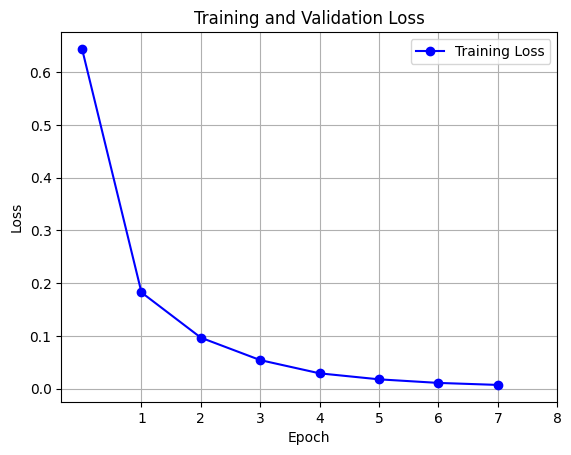

In [36]:
def plot_loss(training_stats):
    df_stats = pd.DataFrame(data=training_stats)
    fig, ax = plt.subplots()
    ax.plot(df_stats['Training Loss'], 'b-o', label='Training Loss')
    ax.set_title('Training and Validation Loss')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Loss')
    ax.set_xticks(np.arange(len(df_stats))+1)
    ax.legend(loc='best')
    ax.grid(True)
    plt.show();

plot_loss(training_stats)

## Evaluate Model

In [37]:
def evaluate_model(model, tokenizer, test_texts, test_labels, batch_size=32, max_len=64, device='cpu'):
    """
    Evaluate a text classification model on test data.

    Parameters
    ----------
    model : pre-trained text classification model
        The model to be evaluated.
    tokenizer : tokenizer
        The tokenizer used to preprocess the text data.
    test_texts : list
        A list of texts to be used as test data.
    test_labels : list
        A list of labels corresponding to the test texts.
    batch_size : int, optional
        Batch size for processing the test data. Default is 32.
    max_len : int, optional
        The maximum length of a text sequence. Default is 64.
    device : str, optional
        Device for running the model, either 'cpu' or 'cuda'. Default is 'cpu'.

    Returns
    -------
    report_df : DataFrame
        A dataframe containing the precision, recall, and F-score for each class as well as their macro-averaged values.
    accuracy : float
        The accuracy of the model on the test data.
    disp : ConfusionMatrixDisplay
        A confusion matrix display showing the predicted vs. true labels.
    """

    # Encode texts and create tensors for input_ids and attention masks
    encoded_inputs = []
    for text in test_texts:
        encoded_input = tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=max_len,
            pad_to_max_length=True,
            return_attention_mask=True,
            return_tensors='pt',
        )
        encoded_inputs.append(encoded_input)
    input_ids = torch.cat([e['input_ids'] for e in encoded_inputs], dim=0)
    attention_masks = torch.cat([e['attention_mask'] for e in encoded_inputs], dim=0)
    labels = torch.tensor(test_labels)

    # Create a TensorDataset and a DataLoader for evaluation
    dataset = TensorDataset(input_ids, attention_masks, labels)
    sampler = SequentialSampler(dataset)
    dataloader = DataLoader(dataset, sampler=sampler, batch_size=batch_size)

    # Evaluate the model on test data
    print('Evaluation started on test data')
    model.eval()
    predictions, true_labels = [], []
    for batch in dataloader:
        batch = tuple(t.to(device) for t in batch)
        b_input_ids, b_input_mask, b_labels = batch
        with torch.no_grad():
            outputs = model(b_input_ids, token_type_ids=None, attention_mask=b_input_mask)
        logits = outputs[0]
        logits = logits.detach().cpu().numpy()
        label_ids = b_labels.to('cpu').numpy()
        predictions.append(logits)
        true_labels.append(label_ids)
    print('Evaluation completed')

    # Calculate evaluation metrics and display confusion matrix
    predicted_labels = np.argmax(np.concatenate(predictions, axis=0), axis=1)
    class_names =['INSULT','OTHER','PROFANITY','RACIST','SEXIST']
    cm = confusion_matrix(test_labels, predicted_labels)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    disp.plot();
    f_score = f1_score(test_labels, predicted_labels, average='macro')
    precision = precision_score(test_labels, predicted_labels, average='macro')
    recall = recall_score(test_labels, predicted_labels, average='macro')
    accuracy = accuracy_score(test_labels, predicted_labels)
    report = classification_report(test_labels, predicted_labels, target_names=class_names, output_dict=True)
    report_df = pd.DataFrame(report).transpose()
    report_df = report_df.drop(columns=['support'])
    report_df = report_df.rename(columns={
        'f1-score':'F-Score',
        'precision':'Precision',
        'recall':'Recall'
    })
    return report_df, f_score, disp

In [39]:
test_texts = test.text.values
test_labels = test.target.values

Evaluation started on test data
Evaluation completed


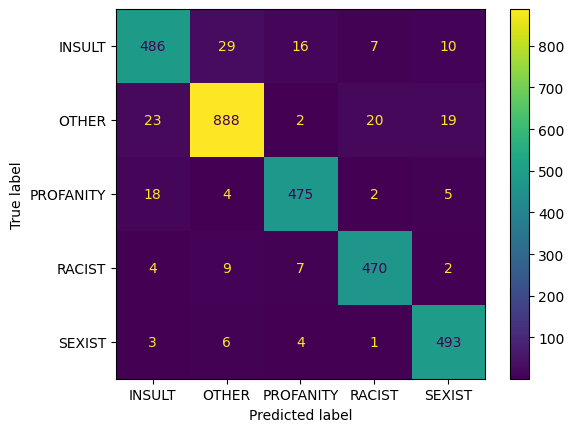

In [42]:
report_df, f_score, disp = evaluate_model(model, tokenizer, test_texts, test_labels, batch_size=32, max_len=64, device=device)

In [43]:
report_df

,Precision,Recall,F-Score
INSULT,0.910112,0.886861,0.898336
OTHER,0.948718,0.932773,0.940678
PROFANITY,0.942460,0.942460,0.942460
RACIST,0.940000,0.955285,0.947581
SEXIST,0.931947,0.972387,0.951737
accuracy,0.936397,0.936397,0.936397
macro avg,0.934648,0.937953,0.936159
weighted avg,0.936363,0.936397,0.936249


## Loading the Pre-trained Model and Tokenizer

In [44]:
from transformers import BertTokenizer,BertTokenizerFast, TFBertForSequenceClassification, BertConfig, TFBertModel
model_path = "/content/drive/MyDrive/Nane&Limon/Teknofest 2023 DDI Yarışması Dosyalarım/bigscience_t0_model"
tokenizer_path = "/content/drive/MyDrive/Nane&Limon/Teknofest 2023 DDI Yarışması Dosyalarım/bigscience_t0_tokenizer"
model = TFBertForSequenceClassification.from_pretrained(model_path, from_pt=True) # modify labels as needed.
tokenizer = BertTokenizer.from_pretrained(tokenizer_path, do_lower_case=True)

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertForSequenceClassification: ['bert.embeddings.position_ids']
- This IS expected if you are initializing TFBertForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertForSequenceClassification from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertForSequenceClassification were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertForSequenceClassification for predictions without further training.


## Understanding Model Predictions with SHAP

--- 
Aşğıda kullanılan örneklemler, bir makine öğrenmesi modelinin tahminlerinin analiz edilmesi amacıyla oluşturulan bir örnek veri çerçevesidir. SHAP (SHapley Additive exPlanations) değerleri kullanılarak her bir metnin tahmininde hangi özelliklerin (kelimelerin) en çok katkı sağladığını anlayabiliriz.

### Veri Seti Açıklaması

Veri seti, "shap_df" adlı bir pandas veri çerçevesi olarak sunulmaktadır. Veri çerçevesi, iki sütundan oluşur:

- "text" sütunu, metin örneklerini içerir.
- "target" sütunu, her bir metin örneğine atanan etiketleri ("PROFANITY", "RACIST", "INSULT" ve "OTHER" gibi) temsil eder.

### SHAP Değerleri

SHAP değerleri, bir makine öğrenmesi modelinin tahminlerinin açıklanması için kullanılan bir yöntemdir. Bu yöntem, bir metnin tahminindeki her bir kelimenin katkısını hesaplar. Böylece, modelin nasıl çalıştığını ve hangi özelliklere (kelimelere) güvendiğini anlayabiliriz.

### SHAP Değerleriyle Makine Öğrenimi Modelleri Nasıl Yorumlanır?

SHAP Analizi ile ilgili daha fazla bilgi edinmek için daha önce bu konuyla ilgili yazmış olduğum 
[Medium yazısına](https://medium.com/@tarikkaan1koc/shap-analizi-shap-de%C4%9Ferleriyle-makine-%C3%B6%C4%9Frenimi-modelleri-nas%C4%B1l-yorumlan%C4%B1r-e95710e4aa0c) ve [Shap Library dokümantasyona](https://shap.readthedocs.io/en/latest/index.html) göz atabilirsiniz.

### Hedef

SHAP değerleri kullanılarak, her bir metnin tahmininde hangi kelimelerin en çok katkı sağladığını belirlemek. Bu sayede, modelin çalışma prensibini daha iyi anlayabilir ve gerektiğinde iyileştirmeler yapabiliriz.

In [45]:
shap_df.drop("Unnamed: 0", inplace=True, axis=1)
shap_df

,text,target
0,*Sakallı lavuk trans kız olduğunu iddia eden t...,RACIST
1,48 kilo kizmi olur amk kadın dediğin ele avuca...,PROFANITY
2,Ay bokum 1.60 altı kadınlar kendine kadınım de...,PROFANITY
3,Bakire kız arıyorsan sen de bakir erkek olacak...,PROFANITY
4,Berlin düşüp faşizm kaybettikten sonra Kızıl O...,RACIST
5,biz bu hayatta hic esmer 1.80+ yakisikli cocuk...,OTHER
6,Çocuğun şu ortama girmek için yalandan dinledi...,PROFANITY
7,Erkek adam onu ben hallederim deyip söküp daha...,PROFANITY
8,Lezbiyen ya da aldatılmış sivilceli şişman bı ...,PROFANITY
9,Geldi yine tibini fofenklediim top sakallı gız,PROFANITY


In [64]:
def process_text_classification(text, model, tokenizer):
    """
    Applies text classification on given text using provided `model` and `tokenizer`.

    Parameters
    ----------
    text : list of str
        List of text samples to classify.
    model : BertForSequenceClassification
        Trained BertForSequenceClassification model.
    tokenizer : BertTokenizer
        Tokenizer used for tokenizing the input text.

    Returns
    -------
    list of str
        List of classification results in the format of '{label} - {text sample}'.
    """
    pipe = TextClassificationPipeline(model=model, tokenizer=tokenizer)
    label_map = {
        'LABEL_0': 'INSULT',
        'LABEL_1': 'OTHER',
        'LABEL_2': 'PROFANITY',
        'LABEL_3': 'RACIST',
        'LABEL_4': 'SEXIST'
    }

    results = [f"{i['label']} - {index}" for index, i in enumerate(pipe(text))]
    mapped_results = [f"{label_map[i['label'].upper()]} - {text[index]}" for index, i in enumerate(pipe(text))]

    return mapped_results

In [66]:
text = shap_df.text.to_list()
text

['*Sakallı lavuk trans kız olduğunu iddia eden tweet atar*\r\n\r\nMaksimum 30takipcili Sünni hetero anon erkekler:',
 '48 kilo kizmi olur amk kadın dediğin ele avuca gelicek haksizmiyim',
 'Ay bokum 1.60 altı kadınlar kendine kadınım demesin',
 'Bakire kız arıyorsan sen de bakir erkek olacaksın. Milli olmak uçkuru bozuk güruhun uydurması.. her kültür doğru değil',
 'Berlin düşüp faşizm kaybettikten sonra Kızıl Ordu askerlerinin teca.. pardon özgürleştirdiği kadınlar...',
 'biz bu hayatta hic esmer 1.80+ yakisikli cocuklardan cekmedik. hep kumral 1.70 yer cucesi buyuyememis sivilceli suratli ergenlerden cektik',
 'Çocuğun şu ortama girmek için yalandan dinlediği dertleri, diğer erkekler gibi değilim tavırlarını, insta fotolarının altına bıraktığı siyah kalpleri düşününce karnıma kramp girdi aq.',
 'Erkek adam onu ben hallederim deyip söküp daha da anasını sikince tamirciye gider',
 "Lezbiyen ya da aldatılmış sivilceli şişman bı Ergen'in teki olmalı.",
 'Geldi yine tibini fofenklediim to

In [67]:
results = process_text_classification(text, model, tokenizer)

for pred in results:
    print(pred)

RACIST - *Sakallı lavuk trans kız olduğunu iddia eden tweet atar*

Maksimum 30takipcili Sünni hetero anon erkekler:
SEXIST - 48 kilo kizmi olur amk kadın dediğin ele avuca gelicek haksizmiyim
SEXIST - Ay bokum 1.60 altı kadınlar kendine kadınım demesin
SEXIST - Bakire kız arıyorsan sen de bakir erkek olacaksın. Milli olmak uçkuru bozuk güruhun uydurması.. her kültür doğru değil
OTHER - Berlin düşüp faşizm kaybettikten sonra Kızıl Ordu askerlerinin teca.. pardon özgürleştirdiği kadınlar...
OTHER - biz bu hayatta hic esmer 1.80+ yakisikli cocuklardan cekmedik. hep kumral 1.70 yer cucesi buyuyememis sivilceli suratli ergenlerden cektik
SEXIST - Çocuğun şu ortama girmek için yalandan dinlediği dertleri, diğer erkekler gibi değilim tavırlarını, insta fotolarının altına bıraktığı siyah kalpleri düşününce karnıma kramp girdi aq.
PROFANITY - Erkek adam onu ben hallederim deyip söküp daha da anasını sikince tamirciye gider
SEXIST - Lezbiyen ya da aldatılmış sivilceli şişman bı Ergen'in teki olm

In [68]:
!pip install shap -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.4/572.4 KB 15.2 MB/s eta 0:00:00


In [81]:
import shap as sp 
from transformers import pipeline

In [82]:
pred = pipeline("text-classification", model=model, tokenizer=tokenizer, device=0, return_all_scores=True)

`return_all_scores` is now deprecated,  if want a similar funcionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.


In [83]:
explainer = sp.Explainer(pred)

In [84]:
shap_values = explainer(shap_df['text'][:])

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:   6%|▋         | 1/16 [00:00<?, ?it/s]

  0%|          | 0/210 [00:00<?, ?it/s]

Partition explainer:  19%|█▉        | 3/16 [02:12<03:46, 17.39s/it]

  0%|          | 0/156 [00:00<?, ?it/s]

Partition explainer:  25%|██▌       | 4/16 [02:42<04:29, 22.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  31%|███▏      | 5/16 [04:22<09:23, 51.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  38%|███▊      | 6/16 [06:01<11:19, 67.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  44%|████▍     | 7/16 [07:40<11:45, 78.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 8/16 [09:19<11:19, 84.90s/it]

  0%|          | 0/272 [00:00<?, ?it/s]

Partition explainer:  56%|█████▋    | 9/16 [10:06<08:30, 72.90s/it]

  0%|          | 0/306 [00:00<?, ?it/s]

Partition explainer:  62%|██████▎   | 10/16 [11:33<07:44, 77.36s/it]

  0%|          | 0/182 [00:00<?, ?it/s]

Partition explainer:  69%|██████▉   | 11/16 [12:04<05:15, 63.06s/it]

  0%|          | 0/72 [00:00<?, ?it/s]

Partition explainer:  75%|███████▌  | 12/16 [12:16<03:09, 47.44s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  81%|████████▏ | 13/16 [13:55<03:09, 63.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  88%|████████▊ | 14/16 [15:32<02:27, 73.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  94%|█████████▍| 15/16 [17:13<01:21, 81.66s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 16/16 [18:52<00:00, 86.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 17it [20:31, 76.97s/it]


In [86]:
sp.plots.text(shap_values)

---
### INSULT
---

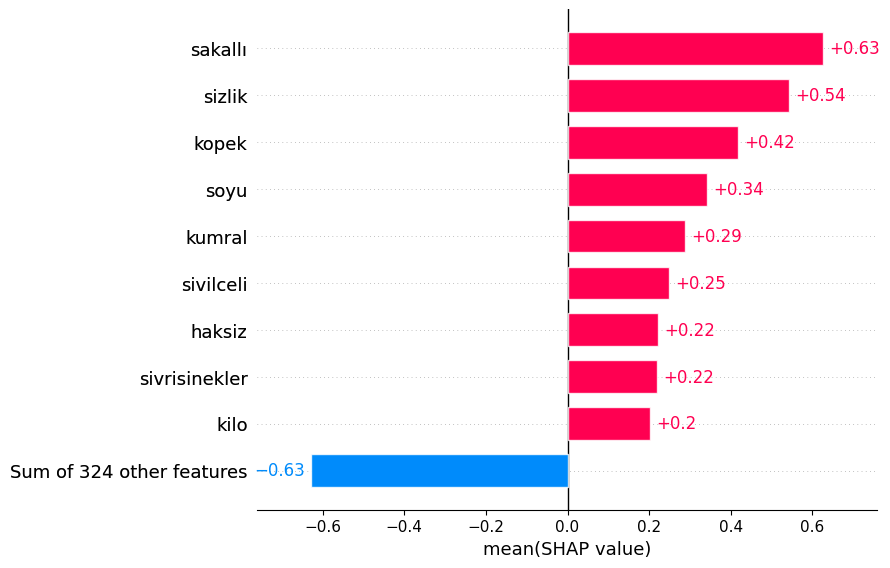

In [126]:
sp.plots.bar(shap_values[:,:,0].mean(0), order= sp.Explanation.argsort.flip);

---
### OTHER
---

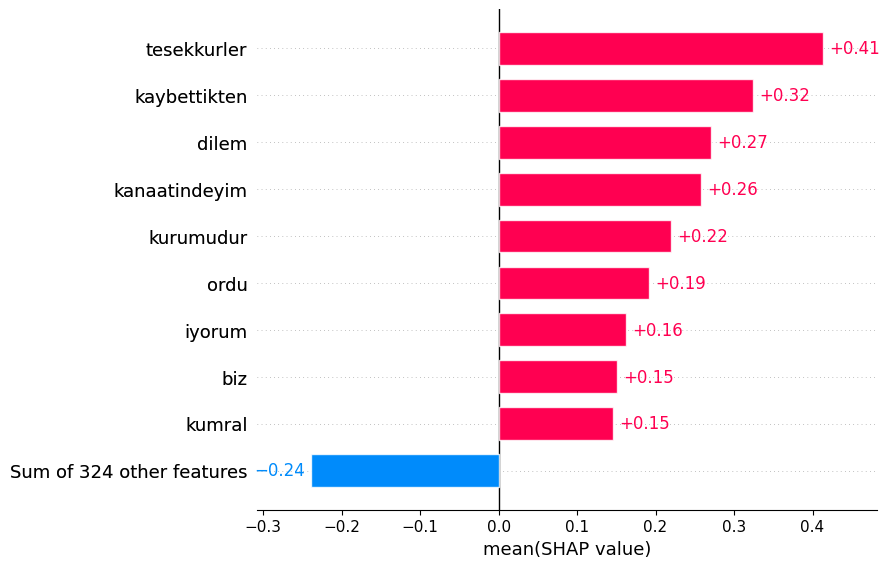

In [132]:
sp.plots.bar(shap_values[:,:,1].mean(0), order= sp.Explanation.argsort.flip);

---
### PROFANITY
---

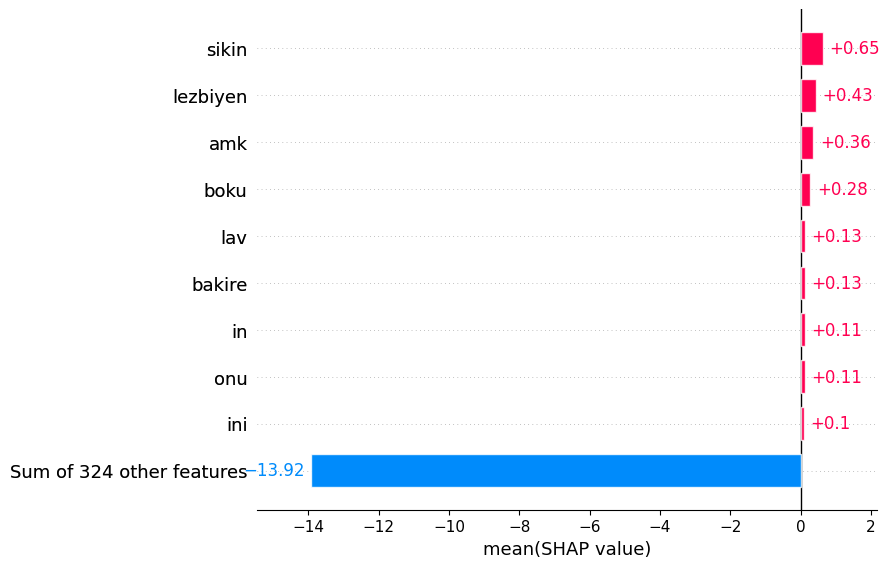

In [133]:
sp.plots.bar(shap_values[:,:,2].mean(0), order= sp.Explanation.argsort.flip);

---
### RACIST
---

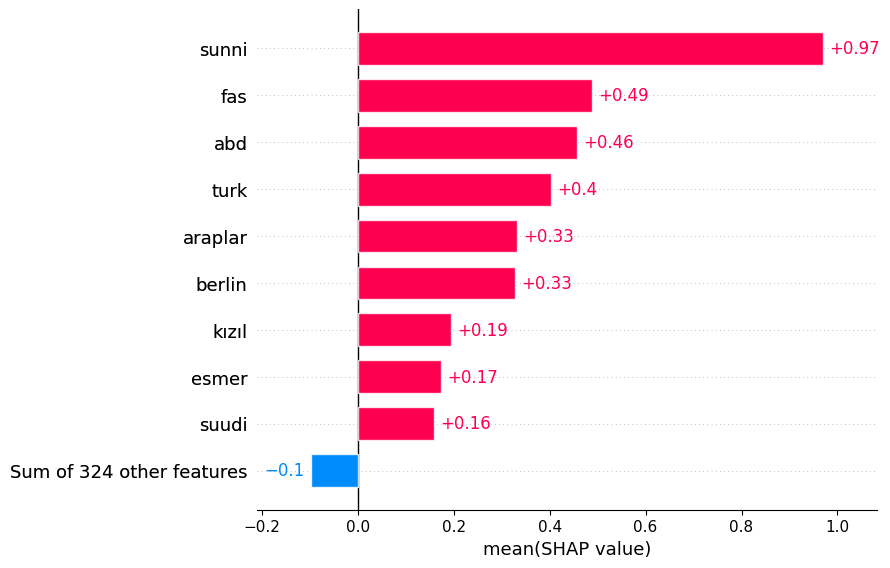

In [135]:
sp.plots.bar(shap_values[:,:,3].mean(0), order= sp.Explanation.argsort.flip);

---
### SEXIST
---

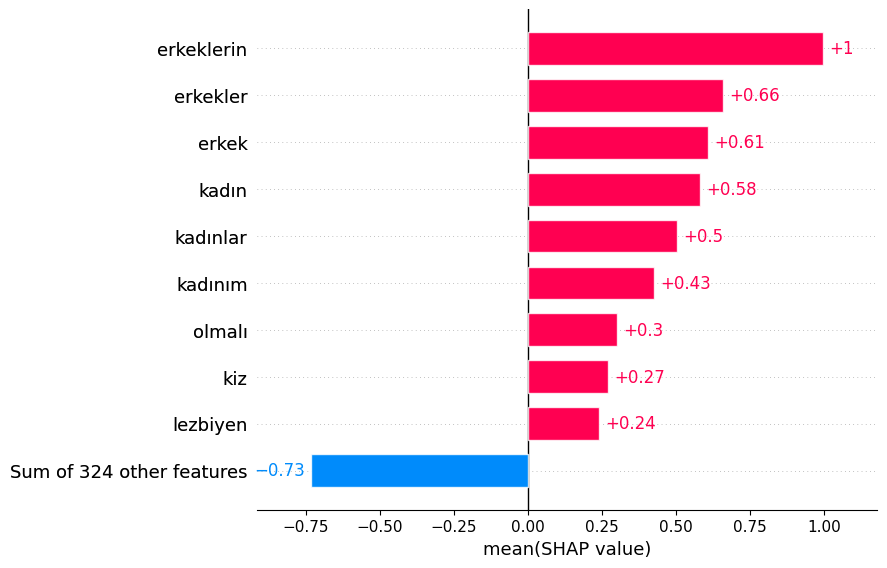

In [134]:
sp.plots.bar(shap_values[:,:,4].mean(0), order= sp.Explanation.argsort.flip);